<h1>Understanding Prolate Jellyfish Locomotion Efficiency through Numerical Simulation of Bell Kinematics.</h1>
<h3>This file is used to create the jellyfish kinematics and plot the results.</h3>

In [15]:
using LinearAlgebra, Printf, Statistics, Plots, ParametricBodies, StaticArrays
using WaterLily, CUDA
using GeometryBasics, Optim
include("viz.jl");

Jellyfish kinematics from Sahin et al. (2009) with a focus on the jetting mechanism.

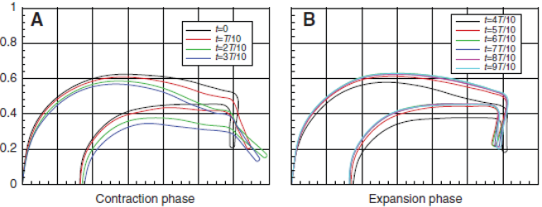

In [3]:
display("image/png", read("Sahin Jetting Jellyfish Kinematics.png"))

Definition of the control points of the moving jellyfish on each time step, derived from above pictures.

In [4]:
T = Float32
# t = 0
cps_0 = SA{T}[0.000  0.024  0.064  0.175  0.323  0.481  0.643  0.798  0.996  1.191  1.228  1.201  1.171  1.178  1.154  0.804  0.606  0.475  0.397  0.340  0.323  
                0.000  0.193  0.333  0.475  0.578  0.623  0.627  0.614  0.571  0.524  0.484  0.213  0.216  0.412  0.456  0.451  0.420  0.348  0.266  0.151 0.000  ] #*L .+ SA{T}[2L,3L]
# t = T/10
cps_1 = SA{T}[0.000  0.024  0.067  0.175  0.326  0.488  0.639  0.794  0.993  1.164  1.198  1.296  1.265  1.171  1.090  0.801  0.606  0.478  0.404  0.343  0.323  
                0.000  0.193  0.326  0.469  0.564  0.609  0.606  0.590  0.537  0.501  0.470  0.216  0.206  0.412  0.426  0.438  0.396  0.335  0.256  0.154  0.000  ] # *L .+ SA{T}[2L, 3L]
# t = 2T/10
cps_2 = SA{T}[0.000  0.024  0.081  0.188  0.333  0.481  0.639  0.798  0.986  1.171  1.222  1.390  1.373  1.205  1.154  0.801  0.616  0.501  0.427  0.370  0.323  
                0.000  0.193  0.319  0.455  0.547  0.589  0.583  0.550  0.473  0.419  0.321  0.173  0.159  0.304  0.334  0.380  0.366  0.311  0.243  0.148 0.000  ] #*L .+ SA{T}[2L,3L]
# t = 3T/10
cps_3 = SA{T}[0.000  0.034  0.091  0.199  0.337  0.481  0.629  0.781  0.973  1.077  1.181  1.346  1.319  1.198  1.154  0.798  0.643  0.522  0.448  0.387  0.357  
                0.000  0.193  0.322  0.448  0.541  0.568  0.566  0.533  0.449  0.412  0.392  0.149  0.135  0.291  0.301  0.343  0.342  0.287  0.226  0.141  0.000  ] # *L .+ SA{T}[2L, 3L]    
# t = 4T/10
cps_4 = SA{T}[0.000  0.027  0.081  0.199  0.357  0.478  0.626  0.781  0.976  1.178  1.222  1.228  1.191  1.195  1.151  0.801  0.633  0.525  0.438  0.384  0.347  
                0.000  0.204  0.326  0.466  0.562  0.589  0.587  0.560  0.507  0.467  0.437  0.200  0.206  0.359  0.389  0.381  0.363  0.315  0.233  0.158  0.000  ] # *L .+ SA{T}[2L, 3L]
# t = 5T/10
cps_5 = SA{T}[0.000  0.027  0.074  0.182  0.340  0.471  0.629  0.791  0.989  1.185  1.222  1.151  1.124  1.164  1.127  0.798  0.616  0.498  0.407  0.360  0.337  
                0.000  0.204  0.340  0.483  0.585  0.620  0.624  0.608  0.561  0.518  0.478  0.237  0.250  0.420  0.454  0.452  0.410  0.352  0.253  0.172  0.000  ] # *L .+ SA{T}[2L, 3L]
# t = 6T/10
cps_6 = SA{T}[0.000  0.027  0.074  0.182  0.330  0.464  0.629  0.794  0.989  1.185  1.225  1.158  1.124  1.164  1.141  0.794  0.613  0.488  0.394  0.343  0.330  
                0.000  0.204  0.340  0.483  0.592  0.637  0.641  0.628  0.592  0.532  0.495  0.233  0.250  0.403  0.454  0.469  0.424  0.366  0.267  0.175  0.000  ] # *L .+ SA{T}[2L, 3L]
# t = 7T/10
cps_7 = SA{T}[0.000  0.027  0.074  0.182  0.330  0.464  0.629  0.794  0.989  1.185  1.225  1.178  1.144  1.164  1.141  0.794  0.613  0.488  0.394  0.343  0.330  
                0.000  0.204  0.340  0.483  0.592  0.637  0.641  0.628  0.592  0.532  0.495  0.227  0.230  0.403  0.454  0.469  0.424  0.366  0.267  0.175  0.000  ] # *L .+ SA{T}[2L, 3L]
# t = 8T/10
cps_8 = SA{T}[0.000  0.027  0.074  0.182  0.330  0.464  0.629  0.794  0.989  1.185  1.225  1.185  1.151  1.164  1.141  0.794  0.613  0.488  0.394  0.343  0.330  
                0.000  0.204  0.340  0.483  0.592  0.637  0.641  0.628  0.592  0.532  0.495  0.230  0.233  0.403  0.454  0.469  0.424  0.366  0.267  0.175  0.000  ] # *L .+ SA{T}[2L, 3L]
# t = 9T/10
cps_9 = SA{T}[0.000  0.027  0.074  0.182  0.330  0.464  0.629  0.794  0.989  1.185  1.225  1.191  1.154  1.164  1.141  0.794  0.613  0.488  0.394  0.343  0.330  
                0.000  0.204  0.340  0.483  0.592  0.637  0.641  0.628  0.592  0.532  0.495  0.220  0.220  0.403  0.454  0.469  0.424  0.366  0.267  0.175  0.000  ] # *L .+ SA{T}[2L, 3L]

cps_list = [cps_0, cps_1, cps_2, cps_3, cps_4, cps_5, cps_6, cps_7, cps_8, cps_9] #10-element (Vector{SMatrix{2, 22, Float32, 44}})

mirror_set(cps::SMatrix{2,N,T}) where {N,T} =                # Mirror around the x-axis: (x, y) -> (x, -y)
    SMatrix{2,2,T}(1, 0, 0, -1) * cps

function mirror_x_list(cps_list::AbstractVector{<:SMatrix{2,N,T}}) where {N,T}  # Creates a list with all mirrored control points of all sets
    mirrored_cps_list = similar(cps_list)
    map!(mirror_set, mirrored_cps_list, cps_list)
    return mirrored_cps_list
end

function make_symmetric_jelly(cps_list::AbstractVector{<:SMatrix{2,N,T}};
                                     tol = nothing) where {N,T}
    tol === nothing && (tol = sqrt(eps(T)))

    first_cps = cps_list[1]
    keep_idxs = findall(j -> abs(first_cps[2, j]) > tol, 1:N)   # length K
    K = length(keep_idxs)
    M = N + K + 1                                               # Final column count, added 1 for the 0,0 point
    keep_rev = Tuple(reverse(keep_idxs))                        # Reverse order for mirrored control points

    build_sym_jelly(cps::SMatrix{2,N,T}) where {N,T} = SMatrix{2,M,T}(
        ntuple(2M) do k
            if k <= 2N                                          # Original control points   
                i = (k - 1) % 2 + 1
                j = (k + 1) ÷ 2
                cps[i, j]
            elseif k <= 2N + 2K                                 # Create the mirrored control points and add them to the original
                kk  = k - 2N
                i   = (kk - 1) % 2 + 1
                jth = (kk + 1) ÷ 2
                col = keep_rev[jth]
                i == 1 ? cps[1, col] : -cps[2, col]
            else
                0                                               # Add the 0,0 point, 1st data point, again at the end.
            end
        end
    )

    map(build_sym_jelly, cps_list)                                    
end

function reverse_cps_order(cps::SMatrix{2,N,T}) where {N,T}         # To create the counterclockwise order
    SMatrix{2,N,T}(cps[:, reverse(1:N)])                        # Make SMatrix so that my NURBS function works
end

mirrored = mirror_x_list(cps_list)                               # Mirror the shape around the x-axis
cps_list = make_symmetric_jelly(cps_list)                # Vector{Matrix{Float32}}

cps_list = map(reverse_cps_order, cps_list)                         # Change the cps_list from clockwise to counterclockwise order
@show cps_list                  # Should be a Vector{SMatrix{2, 41, Float32, 82}} in order to be compatible with NURBS

10-element Vector{SMatrix{2, 41, Float32, 82}}:
 [0.0 0.024 … 0.024 0.0; 0.0 -0.193 … 0.193 0.0]
 [0.0 0.024 … 0.024 0.0; 0.0 -0.193 … 0.193 0.0]
 [0.0 0.024 … 0.024 0.0; 0.0 -0.193 … 0.193 0.0]
 [0.0 0.034 … 0.034 0.0; 0.0 -0.193 … 0.193 0.0]
 [0.0 0.027 … 0.027 0.0; 0.0 -0.204 … 0.204 0.0]
 [0.0 0.027 … 0.027 0.0; 0.0 -0.204 … 0.204 0.0]
 [0.0 0.027 … 0.027 0.0; 0.0 -0.204 … 0.204 0.0]
 [0.0 0.027 … 0.027 0.0; 0.0 -0.204 … 0.204 0.0]
 [0.0 0.027 … 0.027 0.0; 0.0 -0.204 … 0.204 0.0]
 [0.0 0.027 … 0.027 0.0; 0.0 -0.204 … 0.204 0.0]

cps_list = SMatrix{2, 41, Float32, 82}[[0.0 0.024 0.064 0.175 0.323 0.481 0.643 0.798 0.996 1.191 1.228 1.201 1.171 1.178 1.154 0.804 0.606 0.475 0.397 0.34 0.323 0.34 0.397 0.475 0.606 0.804 1.154 1.178 1.171 1.201 1.228 1.191 0.996 0.798 0.643 0.481 0.323 0.175 0.064 0.024 0.0; 0.0 -0.193 -0.333 -0.475 -0.578 -0.623 -0.627 -0.614 -0.571 -0.524 -0.484 -0.213 -0.216 -0.412 -0.456 -0.451 -0.42 -0.348 -0.266 -0.151 0.0 0.151 0.266 0.348 0.42 0.451 0.456 0.412 0.216 0.213 0.484 0.524 0.571 0.614 0.627 0.623 0.578 0.475 0.333 0.193 0.0], [0.0 0.024 0.067 0.175 0.326 0.488 0.639 0.794 0.993 1.164 1.198 1.296 1.265 1.171 1.09 0.801 0.606 0.478 0.404 0.343 0.323 0.343 0.404 0.478 0.606 0.801 1.09 1.171 1.265 1.296 1.198 1.164 0.993 0.794 0.639 0.488 0.326 0.175 0.067 0.024 0.0; 0.0 -0.193 -0.326 -0.469 -0.564 -0.609 -0.606 -0.59 -0.537 -0.501 -0.47 -0.216 -0.206 -0.412 -0.426 -0.438 -0.396 -0.335 -0.256 -0.154 0.0 0.154 0.256 0.335 0.396 0.438 0.426 0.412 0.206 0.216 0.47 0.501 0.537 0.59 0.6

In [5]:
# using StaticArrays, ParametricBodies, Plots


# function hermite_sample_all(cps_list; samples_per_segment::Int=25)
#     k = 1                               # For now I only use the first set in cps_list
#     dataset = cps_list[k]               # 2×N, columns are control points
#     T = eltype(dataset)                 # Float32
#     N = size(dataset, 2)                # number of control points

#     prev(i) = mod1(i-1, N)              # previous index, closed curve
#     next(i) = mod1(i+1, N)              # next index, closed curve

#     # tangents M[:,i] = (P_{i+1} - P_{i-1})/2
#     M = zeros(T, 2, N)                  # Initiate M, 2×N, columns are tangents
#     for i in 1:N
#         M[:, i] = 0.5 .* (dataset[:, next(i)] .- dataset[:, prev(i)])   # Catmull–Rom tangents
#     end
#     @show M
#     # Hermite blend (scalar s), s adjust the 'tension' of the curve, 0.5 is generally applied. Each h is a polynomial of degree 3.
#     # h00, h10, h01, h11 are the Hermite basis functions. Pk and Pkp1 are the control points, Mk and Mkp1 are the tangents at those points.
#     # The result is a 2D point on the Hermite curve at parameter s.
#     hermite(Pk, Mk, Pkp1, Mkp1, s) = begin
#         s2 = s*s; s3 = s2*s
#         h00 =  2s3 - 3s2 + 1
#         h10 =    s3 - 2s2 + s
#         h01 = -2s3 + 3s2
#         h11 =    s3 -   s2
#         h00 .* Pk .+ h10 .* Mk .+ h01 .* Pkp1 .+ h11 .* Mkp1
#     end

#     # sample each segment i→i+1; avoid duplicating the join by skipping s=1 except once
#     S = range(0.0, stop=1.0, length=samples_per_segment+1)  # Initiate S, samples_per_segment+1 points in [0,1]
#     C = Matrix{float(T)}(undef, 2, N*samples_per_segment)   # Initiate C, closed: N segments, no duplicate end
#     j = 1
#     for i in 1:N
#         ip1 = next(i)                                       # i+1, next control point index
#         Pk, Pkp1 = dataset[:,i], dataset[:,ip1]             # control points
#         Mk, Mkp1 = M[:,i], M[:,ip1]                         # tangents at control points    
#         for s in S[1:end-1]                                 # skip s=1 to avoid duplicate seam
#             C[:,j] = hermite(Pk, Mk, Pkp1, Mkp1, s)         # sample the Hermite curve at s
#             j += 1
#         end
#     # @show C
#     end
#     return C  # 2×(N*samples_per_segment) closed polyline samples
# end

# # Calculates the derivative of the hermite blend at s, to ensure C¹ continuity at each joint.
# hermite_tangent(Pk, Mk, Pkp1, Mkp1, s) = begin
#     s2 = s*s
#     (6s2 - 6s) .* Pk .+ (3s2 - 4s + 1) .* Mk .+
#     (-6s2 + 6s) .* Pkp1 .+ (3s2 - 2s) .* Mkp1
# end

# # Verify C1 at every control point for the closed curve in cps_list[1]
# function seam_angles_deg(cps_list)
#     dataset = cps_list[1]
#     N = size(dataset, 2)
#     prev(i) = mod1(i-1, N)
#     next(i) = mod1(i+1, N)

#     # Catmull–Rom tangents
#     M = similar(dataset)            # Initiate M, 2×N, columns are tangents
#     for i in 1:N
#         M[:, i] = 0.5 .* (dataset[:, next(i)] .- dataset[:, prev(i)])
#     end

#     ang = zeros(Float64, N)         # Initiate angle array, Float64 for precision
#     for i in 1:N
#         im1 = prev(i); ip1 = next(i)    # previous and next indices
#         # left tangent at joint i: from segment (im1 -> i) at s=1
#         tL = hermite_tangent(dataset[:, im1], M[:, im1], dataset[:, i], M[:, i], 1.0)   # take derivative of hermite at s=1
#         # right tangent at joint i: from segment (i -> ip1) at s=0
#         tR = hermite_tangent(dataset[:, i], M[:, i], dataset[:, ip1], M[:, ip1], 0.0)   # take derivative of hermite at s=0
#         c = dot(tL, tR) / (norm(tL)*norm(tR))          # calculate cosine angle between tangent vectors
#         ang[i] = acosd(clamp(c, -1, 1))                # angle in degrees, clamp to avoid numerical issues
#     end
#     return ang
# end

# angles = seam_angles_deg(cps_list)          # Calculate angles at each seam and add to array
# @show maximum(angles)                       # should be ~ 0.0 (numerical noise)

# r = 2              # samples_per_segment
# n = 22 * r         # number of control points in total
# samples = SMatrix{2,82,Float32}(hermite_sample_all(cps_list; samples_per_segment=r))
# @show size(samples)
# @show typeof(samples)

# curve = BSplineCurve(samples, degree=2)
# plot(curve; aspect_ratio=:equal, linewidth=2, color=:green)


# # plot(samples[1,:], samples[2,:]; aspect_ratio=:equal, linewidth=2, color=:green)
# # scatter!(cps_list[1][1,:], cps_list[1][2,:]; label="control")

<h4>Static plots of the different time steps during jellyfish motion.</h4>
To do: Improve the plots.

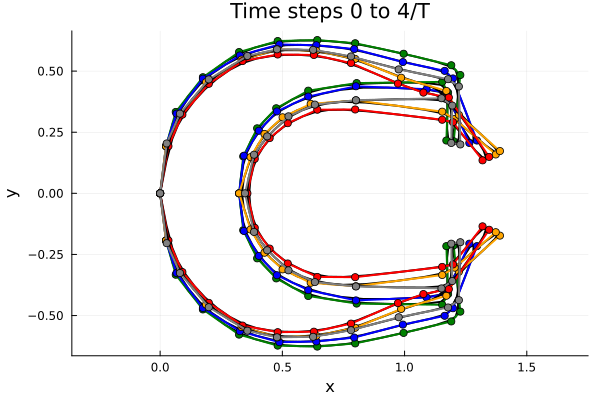

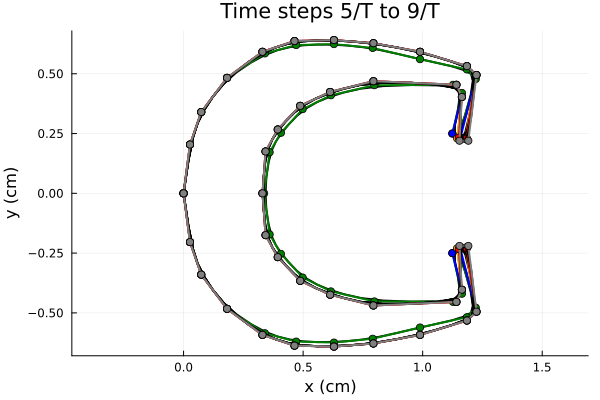

Area difference: -2.3947190635712388%
Old shape area: [0.6263556021071811, 0.611356145097774, 0.6177775555278519, 0.6357639683693455, 0.6389498255458429, 0.6271209803827259, 0.6376589884458187, 0.6399818370256857, 0.6403366269714189, 0.642279485421641][1]
New shape area: [0.6263556021071811, 0.611356145097774, 0.6177775555278519, 0.6357639683693455, 0.6389498255458429, 0.6271209803827259, 0.6376589884458187, 0.6399818370256857, 0.6403366269714189, 0.642279485421641][2]


In [6]:
function poly_area(points::Vector{SVector{2,T}}) where T # Polygon area using the shoelace formula
    n = length(points)
    sum = zero(T)
    for i in 1:n
        x1, y1 = points[i]
        x2, y2 = points[mod1(i+1, n)]
        sum += x1 * y2 - x2 * y1
    end
    return abs(sum) / 2
end

function plot_shapes()  # Plot the shapes and calculate area differences (actually only percentage difference between set 2 and set 1)

    s_vals = range(0, stop=1, length=500)

    curves = [BSplineCurve(cps; degree=2) for cps in cps_list]
    points = [[curve(s) for s in s_vals] for curve in curves]
    areas = [poly_area(pts) for pts in points]

    diff = (areas[2] - areas[1])/ areas[1] * 100  # percentage difference
    println("Area difference: ", diff , "%")
    println("Old shape area: $areas[1]")
    println("New shape area: $areas[2]")

    plt0_4 = plot(curves[1]; label="0", aspect_ratio=:equal, linewidth=2, color=:green)
    plot!(plt0_4, curves[2]; label="1/T", linewidth=2, color=:blue)
    plot!(plt0_4, curves[3]; label="2/T", linewidth=2, color=:orange)
    plot!(plt0_4, curves[4]; label="3/T", linewidth=2, color=:red)
    plot!(plt0_4, curves[5]; label="4/T", linewidth=2, color=:grey,
        xlabel="x", ylabel="y", title="Time steps 0 to 4/T", legend=:true)
    
    labels = ["5/T", "6/T", "7/T", "8/T", "9/T"]
    plt5_9 = plot(curves[6]; aspect_ratio=:equal, linewidth=2, color=:green, legend=:true)
    plot!(plt5_9, curves[7]; linewidth=2, color=:blue)
    plot!(plt5_9, curves[8]; linewidth=2, color=:orange)
    plot!(plt5_9, curves[9]; linewidth=2, color=:red)
    plot!(plt5_9, curves[10]; linewidth=2, color=:grey,
        xlabel="x (cm)", ylabel="y (cm)", title="Time steps 5/T to 9/T")

    display(plt0_4)
    display(plt5_9)
end

plot_shapes()

First trial to compute velocities between control point changes.

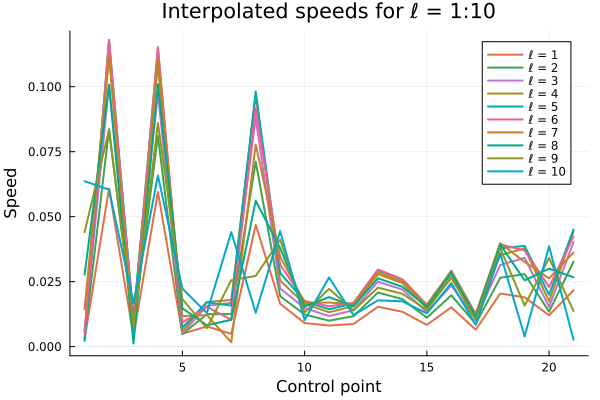

In [7]:

## Calculating the velocity of points from the tangents of frames assuming that the period T is 10 seconds, so every timestep is T/10
## I am pretty sure this can't work, as I am interpolating between frames instead of control points.
function frame_tangents(cps_list)
    N = length(cps_list)            # Number of control point sets
    # @show N
    T = similar(cps_list)
    for k in 1:N                    # Go through each frame from 1 to N
        prev = cps_list[mod(k-1, N)+1]
        # print("\n prev = ", mod(k-1, N)+1, " ")
        next = cps_list[mod(k, N)+1]
        # print("\n next = ", mod(k,   N)+1, " ")
        T[k] = 0.5 .* (next .- prev)    
        # @show T[k]
    end
    return T         
end

# 2) Hermite blend between frames k and k+1, s∈[0,1]
function hermite_blend(P0, P1, M0, M1, s)
    s2 = s*s; s3 = s2*s
    h00 =  2*s3 - 3*s2 + 1
    h10 =    s3 - 2*s2 + s
    h01 = -2*s3 + 3*s2
    h11 =    s3 -   s2
    return h00 .* P0 .+ h10 .* M0 .+ h01 .* P1 .+ h11 .* M1
end

s = 0:0.1:1

tangents = frame_tangents(cps_list)

interpolate = [Vector{Any}(undef, length(s)) for _ in 1:length(cps_list)]

for k in 1:length(cps_list)
    for j in 1:length(s)
        interpolate[k][j] = hermite_blend(
            cps_list[k],
            cps_list[mod1(k+1, length(cps_list))],
            tangents[k],
            tangents[mod1(k+1, length(cps_list))],
            s[j]
        )
    end
end
k  = 1               # frame index
ℓs = 1:10            # interpolated step index
Jx = 1:21            # x control-point indices
Jy = 22:42           # y control-point indices
Δs = s[2] - s[1]     # 0.1 step size
# println(interpolate[1][1])
interp_veloc = plot(1:21, zeros(21); label="", linewidth=0)  # placeholder to set axes
for ℓ in ℓs
    vx = [(interpolate[k][ℓ+1][j] - interpolate[k][ℓ][j]) / Δs for j in Jx]
    # println("vx = ", vx)
    vy = [(interpolate[k][ℓ+1][j] - interpolate[k][ℓ][j]) / Δs for j in Jy]
    # println("vy = ", vy)
    speeds = sqrt.((vx .^ 2) .+ (vy .^ 2))                   # 21-point speed curve
    plot!(1:21, speeds; label="ℓ = $ℓ", linewidth=2)
end

xlabel!("Control point")
ylabel!("Speed")
title!("Interpolated speeds for ℓ = 1:10")
display(interp_veloc)

Area error between the time steps, this error must be minimised in order to acquire volume conservation (now it could be said that this is 'area conservation', which is required for eventually volume conservation in 3D).

An algorithm was used for which a Julia package was available, the Optim package (documentation on https://julianlsolvers.github.io/Optim.jl/stable/user/minimization/). This uses the area error and the shape error with an operator that defines the balance between both errors. The initial array consists of the digitised control points. It defines the cost function then as: 

cost = $\epsilon_{area}^2 + \lambda \cdot \epsilon_{shape}$

It applies the Nelder-Mead method in multivariate cases. It uses the cost function, initial control points and NM method to acquire optimisation results, after which the minimizer outputs the best control points to acquire the best cost value.

Right now I calculate the area with a 'poly_area' function that uses the shoelace formula. It should be checked that this formula is actually appropriate for this case, although I cannot see why it wouldn't. 

typeof(cps_list) = Vector{SMatrix{2, 41, Float32, 82}}
typeof(cps_list[1]) = SMatrix{2, 41, Float32, 82}
typeof(new_cps_list) = Vector{SMatrix{2, 41, Float32, 82}}
Shape Area Summary:
────────────────────────────────────────────
Curve t/T  Area            Δ% from t = 0  
────────────────────────────────────────────
Curve 1     0.626356        0.00           
Curve 2     0.626388        0.01           
Curve 3     0.626255        -0.02          
Curve 4     0.626327        -0.00          
Curve 5     0.626458        0.02           
Curve 6     0.626312        -0.01          
Curve 7     0.626387        0.01           
Curve 8     0.626361        0.00           
Curve 9     0.626347        -0.00          
Curve 10    0.626424        0.01           


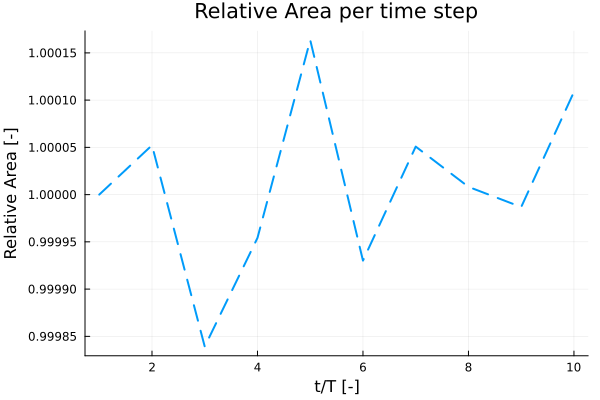

In [8]:
## Initialize the B-spline curves and calculate areas
function optimize_control_points(cps::SMatrix{2,N,T}, reference_area; λ::T = T(1e-3), degree::Int = 2, nsamples::Int = 500) where {N,T}

    # mutable initial vector for Optim
    x0 = vec(Array{Float32}(cps))           # 2N-vector
    s_vals = range(0, stop=1, length=nsamples)

    cost = function (x::AbstractVector)
        # reshape 2N -> 2×N
        X = reshape(x, 2, N)

        # if BSplineCurve accepts AbstractMatrix, pass X directly.
        # If it *requires* StaticArrays, rebuild an SMatrix:
        cps_new = SMatrix{2,N,Float32}(Tuple(vec(X))...)  # same size as cps

        curve = BSplineCurve(cps_new; degree=degree)
        pts = (curve(s) for s in s_vals)
        area = poly_area(collect(pts))

        area_error  = area - reference_area
        shape_error = sum(abs2, x .- x0)                  # keep close to original cps

        return area_error^2 + λ * shape_error
    end

    res = optimize(cost, copy(x0), NelderMead())
    xopt = Optim.minimizer(res)
    Xopt = reshape(xopt, 2, N)

    return SMatrix{2,N,Float32}(Tuple(vec(Xopt))...)
end
@show typeof(cps_list)  # Should be Vector{SMatrix{2, 22, Float32, 44}}

s_vals = range(0, stop=1, length=500)                           # Sample points 
ref_crv = BSplineCurve(cps_list[1]; degree=2)  # Reference curve for area comparison
@show typeof(cps_list[1])
ref_points = [ref_crv(s) for s in s_vals]  # Evaluate the reference curve at the sampled points
reference_area = poly_area(ref_points)  # Calculate the area of the reference polygon
new_cps_list = [optimize_control_points(cps, reference_area) for cps in cps_list]
new_cps_list = Vector{SMatrix{2,41,Float32,82}}(new_cps_list)
crvs = [BSplineCurve(cps; degree=2) for cps in new_cps_list]      # Create a list of B-spline curves from control points

points = [[curve(s) for s in s_vals] for curve in crvs]       # # Evaluate each curve at the sampled points
areas = [poly_area(pts) for pts in points]              # Calculate the area of each polygon defined by the points

@show typeof(new_cps_list)

# Compute percentage difference from first area
reference_area = areas[1] 
rel_area = [area / reference_area for area in areas]
rel_errors = [(area - reference_area) / reference_area * 100 for area in areas]

println("Shape Area Summary:")
println("────────────────────────────────────────────")
@printf("%-10s %-15s %-15s\n", "Curve t/T", "Area", "Δ% from t = 0")
println("────────────────────────────────────────────")
for i in 1:length(areas)
    @printf("Curve %-4d  %-15.6f %-15.2f\n", i, areas[i], rel_errors[i])
end

# plot(1:length(areas), areas; label="Area", xlabel="t/T", ylabel="Area", linewidth=2, legend=:topleft, title="Area per time step")
plot(1:length(rel_area), rel_area; label="Relative Area [-]", xlabel="t/T [-]", ylabel="Relative Area [-]",  linewidth=2, legend=:false, linestyle=:dash, title="Relative Area per time step")


centroids = Any[0.30222222f0, 0.2913377f0, 0.24999925f0, 0.23198372f0, 0.26978314f0, 0.30789164f0, 0.31442156f0, 0.3124556f0, 0.31269085f0, 0.31127954f0]
volumes_aperture = [1.0, 0.9845058591051534, 0.7808608395226168, 0.6295997889220829, 0.7614990296769715, 0.9443055198153885, 1.0160962096677675, 1.0323711187677485, 1.0422033824475994, 1.0415016318904198]


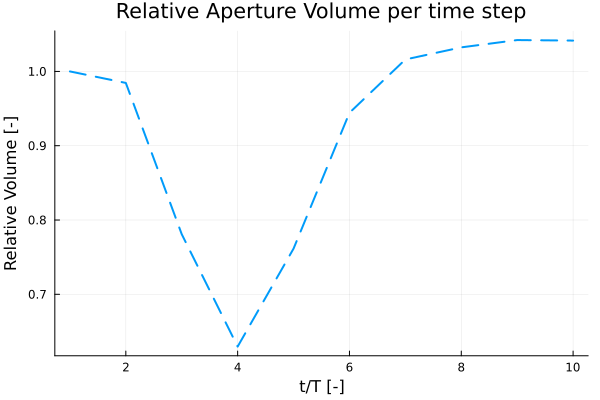

In [9]:
function get_spec_idx(cps_list::Vector{SMatrix{2,N,T,82}}) where {N,T}
    spec_idx = Vector{SMatrix{2,18,T}}()
    centroids = []  # Store centroids for each set
    for cps in cps_list
        idx = hcat(cps[:,13:29],cps[:,13])
        idx2 = cps[2,13:21]
        centroid = abs(sum(idx2)) / length(idx2)  
        push!(centroids, centroid)  # Store the centroid for this set
        push!(spec_idx, idx)
    end
    return spec_idx, centroids
end

specific_cps, centroids = get_spec_idx(new_cps_list)  # Get the specific control points for the inside of the jellyfish
@show centroids

s_vals_aperture = range(0, stop=1, length=500)

curves_aperture = [BSplineCurve(cps; degree=2) for cps in specific_cps]
points_aperture = [[curve(s) for s in s_vals_aperture] for curve in curves_aperture]
areas_aperture = [poly_area(pts) for pts in points_aperture]
volumes_aperture = areas_aperture .* centroids .* 2π    # Is this correct? I think so, but I am not sure.
volumes_aperture = volumes_aperture ./ volumes_aperture[1]  # Normalize the volumes to the first volume
@show volumes_aperture

plot(1:length(volumes_aperture), volumes_aperture; label="Relative Aperture Volume [-]", xlabel="t/T [-]", ylabel="Relative Volume [-]",  linewidth=2, legend=:false, linestyle=:dash, title="Relative Aperture Volume per time step")


Dynamically moving shape with the normalised area error given.

Plots.AnimatedGif("C:\\Users\\evanv\\AppData\\Local\\Temp\\jl_MT8R4Z6De9.gif")
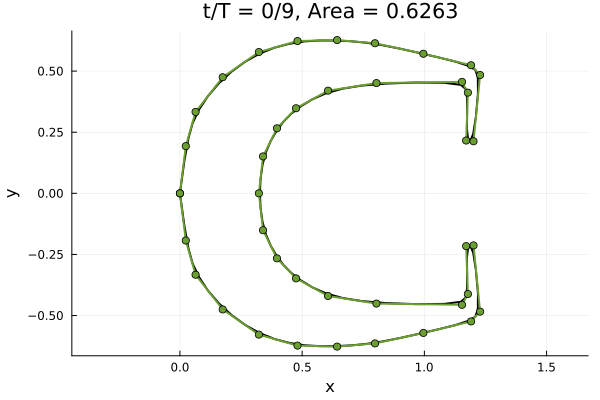

┌ Info: Saved animation to C:\Users\evanv\AppData\Local\Temp\jl_MT8R4Z6De9.gif
└ @ Plots C:\Users\evanv\.julia\packages\Plots\FFuQi\src\animation.jl:156


In [10]:
function interpolate_cps(cp1, cp2, α::T) where T
    return ((1-α).*cp1 .+ α.*cp2)
end

# display(cps_list)

function animate_cps_direct(;loops=4, fps=10)
    degree = 2
    gen_motion = @gif for _ in 1:loops, (i, cps) in enumerate(new_cps_list)
        curve = BSplineCurve(cps; degree=degree)
        s_vals = range(0, stop=1, length=300)
        pts = [curve(s) for s in s_vals]
        area = poly_area(pts)
        plt = plot(curve; aspect_ratio=:equal, label="", linewidth=2,
                   xlabel="x", ylabel="y",
                   title="t/T = $(i-1)/$(length(cps_list)-1), Area = $(round(area, digits=4))")
        plot!(plt, legend=false)
    end every 1 fps=fps
    display(gen_motion)
end

animate_cps_direct()

Static shape testing with both a circle and the jellyfish first set of control points.

cps = Float32[0.0 0.024 0.064 0.175 0.323 0.481 0.643 0.798 0.996 1.191 1.228 1.201 1.171 1.178 1.154 0.804 0.606 0.475 0.397 0.34 0.323 0.34 0.397 0.475 0.606 0.804 1.154 1.178 1.171 1.201 1.228 1.191 0.996 0.798 0.643 0.481 0.323 0.175 0.064 0.024 0.0; 0.0 -0.193 -0.333 -0.475 -0.578 -0.623 -0.627 -0.614 -0.571 -0.524 -0.484 -0.213 -0.216 -0.412 -0.456 -0.451 -0.42 -0.348 -0.266 -0.151 0.0 0.151 0.266 0.348 0.42 0.451 0.456 0.412 0.216 0.213 0.484 0.524 0.571 0.614 0.627 0.623 0.578 0.475 0.333 0.193 0.0]
knots = Float32[0.0, 0.0, 0.0, 0.025641026, 0.051282052, 0.07692308, 0.102564104, 0.12820514, 0.15384616, 0.17948718, 0.20512821, 0.23076923, 0.25641027, 0.2820513, 0.30769232, 0.33333334, 0.35897437, 0.3846154, 0.41025642, 0.43589744, 0.46153846, 0.4871795, 0.51282054, 0.53846157, 0.5641026, 0.5897436, 0.61538464, 0.64102566, 0.6666667, 0.6923077, 0.71794873, 0.74358976, 0.7692308, 0.7948718, 0.82051283, 0.84615386, 0.8717949, 0.8974359, 0.9230769, 0.94871795, 0.974359, 1.0, 1.0, 1

┌ Info: Saved animation to C:\Users\evanv\AppData\Local\Temp\jl_kxs7ITa1iX.gif
└ @ Plots C:\Users\evanv\.julia\packages\Plots\FFuQi\src\animation.jl:156


Plots.AnimatedGif("C:\\Users\\evanv\\AppData\\Local\\Temp\\jl_kxs7ITa1iX.gif")
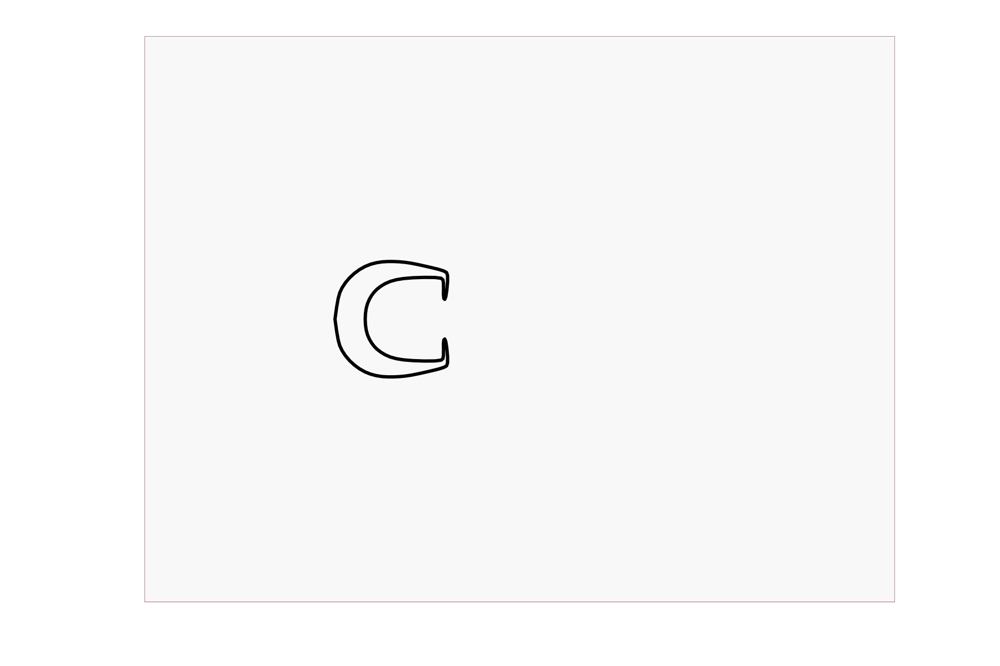

In [11]:
## Static shape testing.
function circle(;L=2^3,Re=250,U=1,mem=Array,T=Float32)              # Trial, why does a circle work?
    # NURBS points, weights and knot vector for a circle
    cps = SA_F32[1 1 0 -1 -1 -1  0  1 1
                0 1 1  1  0 -1 -1 -1 0]*L/2 .+ [2L,3L]
    weights = SA_F32[1.,√2/2,1.,√2/2,1.,√2/2,1.,√2/2,1.]
    knots =   SA_F32[0,0,0,1/4,1/4,1/2,1/2,3/4,3/4,1,1,1]

    # make a nurbs curve and a body for the simulation
    Body = ParametricBody(NurbsCurve(cps,knots,weights))
    Simulation((8L,6L),(U,0),L;U,ν=U*L/Re,body=Body,T=T,mem=mem)
end

### Testing 1 cps set.
function clamped_uniform_knots(p::Int, n::Int)
    k = zeros(Float64, n + p + 1)
    k[p+1:end-p] .= range(0, 1, length=n - p + 1)
    k[end-p+1:end] .= 1.0
    return k
end

function Jellyfish(;L=2^3,Re=250,U=1,ϵ=0.5,mem=Array,T=Float32)
    cps = SA{T}[0.0 0.024 0.064 0.175 0.323 0.481 0.643 0.798 0.996 1.191 1.228 1.201 1.171 1.178 1.154 0.804 0.606 0.475 0.397 0.34 0.323 0.34 0.397 0.475 0.606 0.804 1.154 1.178 1.171 1.201 1.228 1.191 0.996 0.798 0.643 0.481 0.323 0.175 0.064 0.024 0.0;
     0.0 -0.193 -0.333 -0.475 -0.578 -0.623 -0.627 -0.614 -0.571 -0.524 -0.484 -0.213 -0.216 -0.412 -0.456 -0.451 -0.42 -0.348 -0.266 -0.151 0.0 0.151 0.266 0.348 0.42 0.451 0.456 0.412 0.216 0.213 0.484 0.524 0.571 0.614 0.627 0.623 0.578 0.475 0.333 0.193 0.0]*L .+ SA{T}[2L,3L]
    degree = 2
    n_ctrl = size(cps, 2)
    weights = ones(T, n_ctrl)
    knots = T.(clamped_uniform_knots(degree, n_ctrl))
    println("cps = ", cps_list[1])
    println("knots = ", knots)
    println("weights = ", weights)
    curve = NurbsCurve(cps, knots, weights)         
    body = DynamicNurbsBody(curve; thk=3ϵ+√3, boundary=true)

    Simulation((8L,6L),(U,0),L; U, ν=U*L/Re, body, T, mem,ϵ)
end

sim = Jellyfish(mem=Array);
t₀, duration, tstep = sim_time(sim), 10, 0.1;

Tp = eltype(sim.flow.p)

# run
@gif for tᵢ in range(t₀,t₀+duration;step=tstep)
    # update until time tᵢ in the background
    sim_step!(sim,tᵢ)
    # flood plot
    get_omega!(sim);
    plot_vorticity(sim.flow.σ, limit=10)
    plot!(sim.body.curve;shift=(1.5,1.5),add_cp=false)

    println("tU/L=",round(tᵢ,digits=4),", Δt=",round(sim.flow.Δt[end],digits=3))
end

Simulating the jellyfish through changing the control points, but keeping it at one steady location.

Plots.AnimatedGif("C:\\Users\\evanv\\AppData\\Local\\Temp\\jl_uHwJgxsfyX.gif")
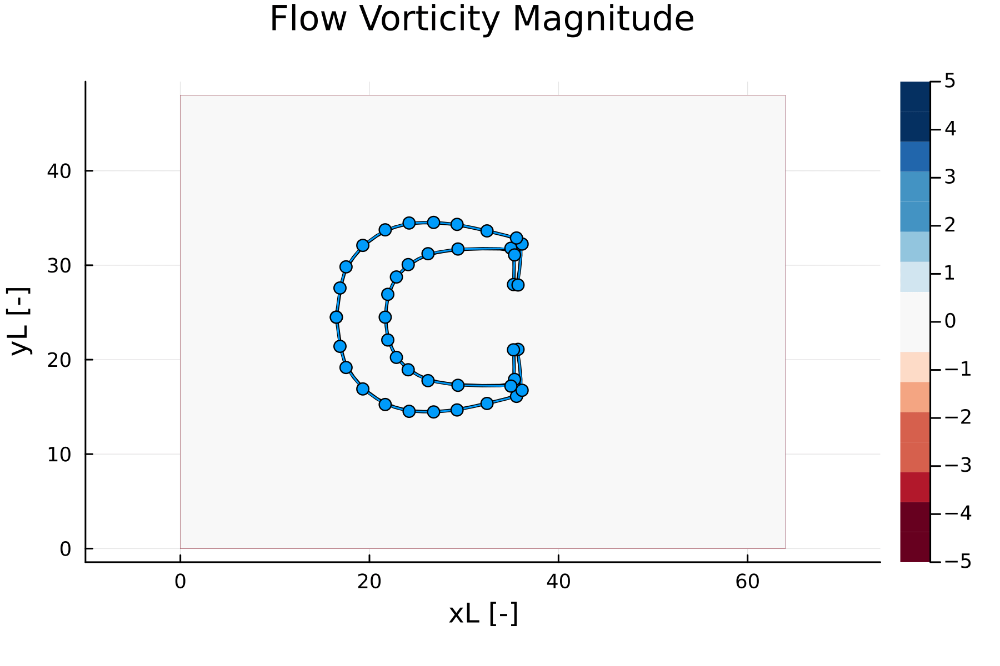

┌ Info: Saved animation to C:\Users\evanv\AppData\Local\Temp\jl_uHwJgxsfyX.gif
└ @ Plots C:\Users\evanv\.julia\packages\Plots\FFuQi\src\animation.jl:156


"dynamic_spline.gif"

In [65]:
function get_centroid(cps::SMatrix{2,N,T}) where {N,T}
    idx = SMatrix{2,18,T}(hcat(cps[:,13:29],cps[:,13]))
    idx2 = cps[2,13:21]
    centroid = Float32(abs(sum(idx2)) / length(idx2))  
    return idx, centroid
end

function clamped_uniform_knots(p::Int, n::Int)
    k = zeros(Float64, n + p + 1)
    k[p+1:end-p] .= range(0, 1, length=n - p + 1)
    k[end-p+1:end] .= 1.0
    return k
end

function dynamicSpline(;L=2^4,Re=500,U=1,ϵ=0.5,thk=2ϵ+√3,mem=Array,T=Float32)
    cps = new_cps_list[1]*L .+ SA{T}[L,3L/2]
    degree = 2
    n_ctrl = size(cps, 2)
    weights = ones(T, n_ctrl)
    knots = T.(clamped_uniform_knots(degree, n_ctrl))

    curve = NurbsCurve(cps, knots, weights)         

    body = DynamicNurbsBody(curve; thk=thk, boundary=true)
    Simulation((4L,3L),(0,0),L; U, ν=U*L/Re, body, T, mem,ϵ, exitBC=true)
end

sim = dynamicSpline(mem=CuArray);
t₀, duration, tstep = sim_time(sim), 20, 0.1;

Tp = eltype(sim.flow.p)

ts = Float32[]
geom_areas = Float32[]
aper_areas = Float32[]
volumes = Float32[]

# storage
pforce,vforce,pmom = [],[],[]

function get_area(cps)
    s_vals = range(0, stop=1, length=500)                          
    curve = BSplineCurve(cps; degree=2)
    points = [curve(s) for s in s_vals]
    area = poly_area(points)
    return area
end

sim_motion = @gif for tᵢ in range(t₀, t₀ + duration; step=tstep)
    t = sum(sim.flow.Δt[1:end-1])
    period = 4 * sim.L / sim.U
    while t < tᵢ * sim.L / sim.U
        τ_total = Tp(t / period)
        frame = floor(Int, τ_total * 10)
        τ_local = τ_total * 10 - frame
        # println("frame", round(frame,digits=4))
        cps_a = new_cps_list[mod(frame, 10) + 1]
        cps_b = new_cps_list[mod(frame+1, 10) + 1]
        fwd_dpl = -0.02*t
        offset = SA{Tp}[sim.L + fwd_dpl, 3sim.L/2]
        interpolated = ((1 - τ_local) .* cps_a .+ τ_local .* cps_b)*sim.L .+ offset
        specific_cps, centroid = get_centroid(interpolated ./ sim.L)  # Get the specific control points for the inside of the jellyfish
        aper_area = get_area(specific_cps)  # Get the area of the specific control points
        int_area = get_area(interpolated ./ sim.L)  # Calculate the area of the interpolated polygon
        # int_range = range(0, stop=1, length=500)                           # Sample points 
        # int_curve = BSplineCurve(interpolated ./sim.L; degree=2)  # Reference curve for area comparison
        # int_points = [int_curve(s) for s in s_vals]  # Evaluate the reference curve at the sampled points
        # int_area = poly_area(int_points)  # Calculate the area of the reference polygon
        sim.body = update!(sim.body, interpolated, sim.flow.Δt[end])    #This updates the body from sim.body to interpolated, it uses Δt to update velocity
        sim_step!(sim; remeasure=true)
        sim.body
        t += sim.flow.Δt[end]
        push!(ts,t)
        push!(geom_areas, int_area)
        push!(aper_areas, aper_area)
        push!(volumes, aper_area * centroid * 2π)
        # compute and store force
        push!(pforce,WaterLily.pressure_force(sim)[1])
        push!(vforce,WaterLily.viscous_force(sim)[1])
    end

    @inside sim.flow.σ[I] = WaterLily.curl(3,I,sim.flow.u) * sim.L / sim.U
    σ = Array(sim.flow.σ)                    # still contains ghost cells
    σi = @view σ[2:end-1, 2:end-1]          # inside domain only

    ux = Array(sim.flow.u[:,:,1])  # velocity in x-direction
    uy = Array(sim.flow.u[:,:,2])  # velocity in y-direction
    ux = @view ux[2:end-1, 2:end-1]  # inside domain only
    uy = @view uy[2:end-1, 2:end-1]
    u = sqrt.(ux.^2 .+ uy.^2)  # magnitude of velocity
    xs = range(0, stop=4*sim.L, length=size(σi,1))
    ys = range(0, stop=3*sim.L, length=size(σi,2))
    # xg = [x for x in xs, y in ys]
    # yg = [y for x in xs, y in ys]
    # stride = 3
    # xg_ds = xg[1:stride:end, 1:stride:end]
    # yg_ds = yg[1:stride:end, 1:stride:end]
    # ux_ds = ux[1:stride:end, 1:stride:end]
    # uy_ds = uy[1:stride:end, 1:stride:end]

    # scale_factor = 0.05
    # Plots.contourf(xs, ys, u'; dpi=300, color=palette(:RdBu_11), clims=(0,2), linewidth=0, aspect_ratio=:equal, legend=true, xlabel="xL [-]", ylabel="yL [-]",title="Flow Velocity Magnitude")
    Plots.contourf(xs, ys, σi'; dpi=300, color=palette(:RdBu_11), clims=(-5,5), linewidth=0, aspect_ratio=:equal, legend=true, xlabel="xL [-]", ylabel="yL [-]",title="Flow Vorticity Magnitude")
    # quiver!(xg_ds, yg_ds, quiver=(ux_ds, uy_ds), arrow=true, color=:black)

    plot!(sim.body.curve; shift=(0.5,0.5), add_cp=true)

    # println("tU/L=", round(tᵢ,digits=4), ", Δt=", round(sim.flow.Δt[end], digits=3))
end

display(sim_motion)

gif_path = "dynamic_spline.gif"

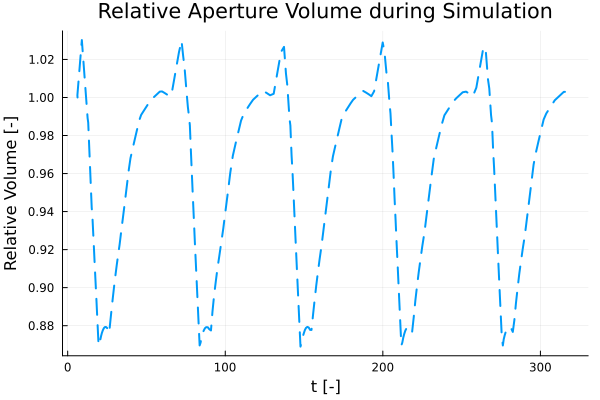

In [45]:
# plot(ts, geom_areas ./ reference_area; label="Relative Area [-]", xlabel="t [-]", ylabel="Relative Area [-]",  linewidth=2, legend=:false, linestyle=:dash, title="Relative Area during Simulation")
plot(ts, volumes ./ volumes[1]; label="Relative Aperture Volume [-]", xlabel="t [-]", ylabel="Relative Volume [-]",  linewidth=2, legend=:false, linestyle=:dash, title="Relative Aperture Volume during Simulation")
# plot(ts, aper_areas ./ aper_areas[1]; label="Relative Aperture Area [-]", xlabel="t [-]", ylabel="Relative Aperture Area [-]",  linewidth=2, legend=:false, linestyle=:dash, title="Relative Aperture Area during Simulation")


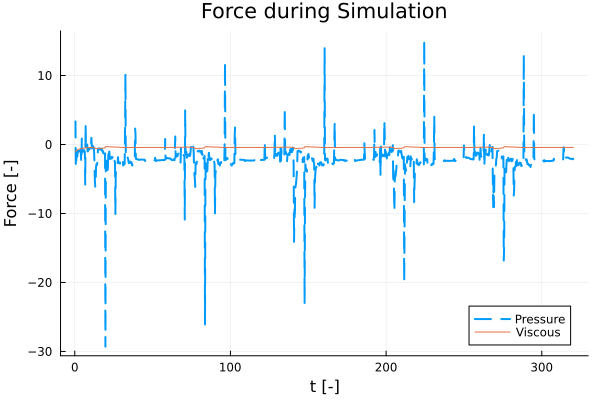

In [48]:
plot(ts[2:end], pforce[2:end] ./ sim.L; label="Pressure", xlabel="t [-]", ylabel="Force [-]",  linewidth=2, legend=:true, linestyle=:dash, title="Force during Simulation")
plot!(ts[2:end], vforce[2:end] ./ sim.L; label="Viscous")

Lets try Makie!

In [34]:
using GLMakie

function get_centroid(cps::SMatrix{2,N,T}) where {N,T}
    idx = SMatrix{2,18,T}(hcat(cps[:,13:29],cps[:,13]))
    idx2 = cps[2,13:21]
    centroid = Float32(abs(sum(idx2)) / length(idx2))  
    return idx, centroid
end

function clamped_uniform_knots(p::Int, n::Int)
    k = zeros(Float64, n + p + 1)
    k[p+1:end-p] .= range(0, 1, length=n - p + 1)
    k[end-p+1:end] .= 1.0
    return k
end

function dynamicSpline(;L=2^4,Re=50,U=1,ϵ=0.5,thk=2ϵ+√3,mem=Array,T=Float32)
    cps = new_cps_list[1]*L .+ SA{T}[L,3L/2]
    degree = 2
    n_ctrl = size(cps, 2)
    weights = ones(T, n_ctrl)
    knots = T.(clamped_uniform_knots(degree, n_ctrl))

    curve = NurbsCurve(cps, knots, weights)         

    body = DynamicNurbsBody(curve; thk=thk, boundary=true)
    Simulation((4L,3L),(U,0),L; U, ν=U*L/Re, body, T, mem,ϵ)
end

sim = dynamicSpline(mem=CuArray);
t₀, duration, tstep = sim_time(sim), 20, 0.1;

Tp = eltype(sim.flow.p)

frames = 1:5  # N = number of time steps

Makie.record("vorticity_velocity.mp4", frames;) do tᵢ
    # === SETUP ===
    t = sum(sim.flow.Δt[1:end-1])
    period = 4 * sim.L / sim.U
    while t < tᵢ * sim.L / sim.U
        τ_total = Tp(t / period)
        frame = floor(Int, τ_total * 10)
        τ_local = τ_total * 10 - frame
        # println("frame", round(frame,digits=4))
        cps_a = new_cps_list[mod(frame, 10) + 1]
        cps_b = new_cps_list[mod(frame+1, 10) + 1]

        offset = SA{Tp}[sim.L, 3sim.L/2]
        interpolated = ((1 - τ_local) .* cps_a .+ τ_local .* cps_b)*sim.L .+ offset
        specific_cps, centroid = get_centroid(interpolated ./ sim.L)  # Get the specific control points for the inside of the jellyfish
        aper_area = get_area(specific_cps)  # Get the area of the specific control points
        int_area = get_area(interpolated ./ sim.L)  # Calculate the area of the interpolated polygon
        # int_range = range(0, stop=1, length=500)                           # Sample points 
        # int_curve = BSplineCurve(interpolated ./sim.L; degree=2)  # Reference curve for area comparison
        # int_points = [int_curve(s) for s in s_vals]  # Evaluate the reference curve at the sampled points
        # int_area = poly_area(int_points)  # Calculate the area of the reference polygon
        sim.body = update!(sim.body, interpolated, sim.flow.Δt[end])    #This updates the body from sim.body to interpolated, it uses Δt to update velocity
        sim_step!(sim; remeasure=true)
        sim.body
        t += sim.flow.Δt[end]
        push!(ts,t)
        push!(geom_areas, int_area)
        push!(aper_areas, aper_area)
        push!(volumes, aper_area * centroid * 2π)
        # compute and store force
        push!(pforce,WaterLily.pressure_force(sim)[1])
        push!(vforce,WaterLily.viscous_force(sim)[1])
    end
    # === FLOW DATA ===
    σ = Array(sim.flow.σ)
    σi = @view σ[2:end-1, 2:end-1]

    ux = @view sim.flow.u[2:end-1, 2:end-1, 1]
    uy = @view sim.flow.u[2:end-1, 2:end-1, 2]

    # Optional downsampling
    stride = 3
    uxs = ux[1:stride:end, 1:stride:end]
    uys = uy[1:stride:end, 1:stride:end]

    xs = range(0, stop=4*sim.L, length=size(σi,1))
    ys = range(0, stop=3*sim.L, length=size(σi,2))
    xg = [x for x in xs[1:stride:end], y in ys[1:stride:end]]
    yg = [y for x in xs[1:stride:end], y in ys[1:stride:end]]

    uvecs = 0.5 .* Point2f.(uxs, uys)

    # === PLOT ===
    f = Figure(resolution=(800,600))
    ax = Axis(f[1,1], aspect=DataAspect())
    heatmap!(ax, xs, ys, σi'; colormap=:RdBu_11, colorrange=(-5,5))
    arrows!(ax, xg, yg, uvecs, arrowsize=10, linecolor=:black)

    # Plot body (convert `sim.body.curve` to points if needed)
    lines!(ax, sim.body.curve[:,1], sim.body.curve[:,2], color=:blue)
    scatter!(ax, sim.body.curve[:,1], sim.body.curve[:,2], color=:cyan, markersize=5)

    f
end

MethodError: MethodError: no method matching record(::var"#272#275", ::String, ::UnitRange{Int64})

Closest candidates are:
  record(::Any, !Matched::Union{Figure, Makie.FigureAxisPlot, Scene}, !Matched::AbstractString, !Matched::Any; kw_args...)
   @ Makie C:\Users\evanv\.julia\packages\Makie\FUAHr\src\recording.jl:152
  record(::Any, !Matched::Union{Figure, Makie.FigureAxisPlot, Scene}, !Matched::AbstractString; kw_args...)
   @ Makie C:\Users\evanv\.julia\packages\Makie\FUAHr\src\recording.jl:146


To do list:
1. Minimize the area difference between time steps to acquire 'area conservation'.
2. Make a GIThub repo of the code and add it as part of the JellyfishGiggles.
3. Plot flow velocity and vorticity around the jellyfish and acquire actual flow data for possible future validation.
4. Assess period of jellyfish motion and adjust the simulation accordingly.
5. Run finer grids to see how the flow is influenced.
6. Eventually, a swimming jellyfish is required. This would require the geometry to dynamically move forward. How to do this?

In [ ]:
## Cubic Hermite / Catmull–Rom interpolation to make it C¹ continuous
using WaterLily, ParametricBodies, StaticArrays, Plots, CUDA, LinearAlgebra
using GeometryBasics
include("viz.jl");

function clamped_uniform_knots(p::Int, n::Int)
    k = zeros(Float64, n + p + 1)
    k[p+1:end-p] .= range(0, 1, length=n - p + 1)
    k[end-p+1:end] .= 1.0
    return k
end

function dynamicSpline(;L=2^3,Re=50,U=1,ϵ=0.5,thk=2ϵ+√3,mem=Array,T=Float32)
    cps = SA{T}[0.000  0.024  0.064  0.175  0.323  0.481  0.643  0.798  0.996  1.191  1.228  1.201  1.171  1.178  1.154  0.804  0.606  0.475  0.397  0.340  0.323  0.000
                0.000  0.193  0.333  0.475  0.578  0.623  0.627  0.614  0.571  0.524  0.484  0.213  0.216  0.412  0.456  0.451  0.420  0.348  0.266  0.151 0.000  0.000]*L .+ SA{T}[L,3L/2]
    degree = 2
    n_ctrl = size(cps, 2)
    weights = ones(T, n_ctrl)
    knots = T.(clamped_uniform_knots(degree, n_ctrl))

    curve = NurbsCurve(cps, knots, weights)         # Does it matter if this is BsplineCurve or NurbsCurve?
    # curve = BSplineCurve(cps; degree=degree)  # use BSplineCurve like in 3D version

    # body = HashedBody(curve, (0.0, 1.0); thk=thk, boundary=true)
    body = DynamicNurbsBody(curve; thk=thk, boundary=true)
    Simulation((4L,3L),(U,0),L; U, ν=U*L/Re, body, T, mem,ϵ)
end

# 1) Precompute per-frame tangents (periodic)
function frame_tangents(cps_list)
    N = length(cps_list)            # Number of control point sets
    @show N
    T = similar(cps_list)
    for k in 1:N                    # Go through each frame from 1 to N
        prev = cps_list[mod(k-2, N)+1]
        # print("\n prev = ", mod(k-2, N)+1, " ")
        next = cps_list[mod(k, N)+1]
        # print("\n next = ", mod(k,   N)+1, " ")
        T[k] = 0.5 .* (next .- prev)        # Catmull–Rom tangents
        @show T[k]
    end
    return T
end

interpolated = hermite_blend(cps_list[k], cps_list[kp1], tangents[k], tangents[kp1], τ_hermite)

tangents = frame_tangents(cps_list)

sim = dynamicSpline(mem=CuArray);
t₀, duration, tstep = sim_time(sim), 10, 0.1;

Tp = eltype(sim.flow.p)

# at top of the file
global prev_interp = nothing
global vmax_hist = Float64[]
global kedge = Int[]

sim_motion = @gif for tᵢ in range(t₀, t₀ + duration; step=tstep)
    t = sum(sim.flow.Δt[1:end-1])
    # println("simu", round(sim.U), "t =", round(tᵢ, digits=4))
    period = 2.0 * sim.L / sim.U
    while t < tᵢ * sim.L / sim.U
        τ_total = Tp(t / period)
        frame = floor(Int, τ_total * 10)
        # println("frame", round(frame,digits=4))
        τ_hermite = τ_total * 10 - frame
        k   = mod(frame, 10) + 1
        kp1 = mod(frame+1, 10) + 1
        # println("k, kp1 = ", k, ", ", kp1)
        interpolated = hermite_blend(cps_list[k], cps_list[kp1], tangents[k], tangents[kp1], τ_hermite)
        interpolated = interpolated * sim.L .+ SA{Tp}[sim.L, 3sim.L/2]

        if prev_interp === nothing
            # first geometry sample: just initialise and move on
            global prev_interp = interpolated
        else
            dt_geo = sim.flow.Δt[end]
            dv  = interpolated .- prev_interp
            vcp = [norm(view(dv, :, j)) / dt_geo for j in 1:size(dv,2)]
            println("vcp: ", vcp)
            global vmax_hist; push!(vmax_hist, maximum(vcp))
            global kedge;     push!(kedge, frame)

            global prev_interp = interpolated
        end
        sim.body = update!(sim.body, interpolated, sim.flow.Δt[end])
        sim_step!(sim; remeasure=true)
        t += sim.flow.Δt[end]
    end

    @inside sim.flow.σ[I] = WaterLily.curl(3,I,sim.flow.u) * sim.L / sim.U
    σ = Array(sim.flow.σ)
    vmin, vmax = extrema(σ)
    # println("vmin, vmax: ", vmin, vmax)
    
    contourf(clamp.(σ, vmin, vmax)', dpi=300,
        color=palette(:RdBu_11), clims=(-150,150), linewidth=0,
        aspect_ratio=:equal, legend=true)
    plot!(sim.body.curve; 
    # shift=(0.5,0.5), 
    add_cp=false)

    println("tU/L=", round(tᵢ,digits=4), ", Δt=", round(sim.flow.Δt[end], digits=3))
end
display(sim_motion)

@show vmax_hist[1:min(end,10)]
@show kedge[1:min(end,10)]

gif_path = "dynamic_spline.gif"



